In [1]:
# mounting g-drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
import requests

In [3]:
import matplotlib.pyplot as plt

In [4]:
# loading prompts from google docs
doc_id = "1VJHTKDMPapyLbACAIOWvzRdrUhV70y03Mbyr_y--AN0"
url = f"https://docs.google.com/document/d/{doc_id}/export?format=txt"
response = requests.get(url)

# decoding with utf-8-sig to remove BOM
text = response.content.decode("utf-8-sig")
prompts = [line.strip() for line in text.split("\n") if line.strip()]


In [5]:
# total number of prompts and first few prompts
print(f"Loaded {len(prompts)} prompts")
print("First 3 prompts:", prompts[:3])

Loaded 49 prompts
First 3 prompts: ['A man baking and preparing donuts to sell at shop.', 'A zebra chews a flower in a fenced in field.', 'A person skiing down a  mountain kicking his leg up.']


In [6]:
prompts

['A man baking and preparing donuts to sell at shop.',
 'A zebra chews a flower in a fenced in field.',
 'A person skiing down a  mountain kicking his leg up.',
 'An airplane in route with a cloudy sky behind it.',
 'A white and blue truck parked in the middle of a dirt road.',
 'PIcked peach flowers sit in a vase with water.',
 'Sheep are on a grassy field and one of them is a white and black baby.',
 'A blue rusted train engine sitting on top of rail tracks.',
 'An open laptop computer sitting on top of a wooden table.',
 'A woman twirling an umbrella with flowers on it.',
 'A woman sitting in a restaurant with Mexican food on her plate',
 'A woman holding a purse and a cellphone.',
 "A cat reaching for a knife that has it's blade out.",
 'The man smiles with a slice of pizza while next to a friend.',
 'Night picture of a car parked and some parking lights in the distance.',
 'A professional photograph of a motorcycle rider in the air.',
 'A person putting doughnuts into a bag in a s

In [8]:
import os

# setting output directory for Generated images from the prompts
output_dir = "/content/drive/MyDrive/Colab Notebooks/J Application Workstation/Dreamslayer/final_outputs"
os.makedirs(output_dir, exist_ok=True)


In [9]:
# importing modelling libraries
import torch
from PIL import Image

In [10]:
### model

In [11]:
from diffusers import AutoPipelineForText2Image

In [12]:
device = "cuda" if torch.cuda.is_available() else "cpu"

# pipeline for generation
pipe = AutoPipelineForText2Image.from_pretrained("stabilityai/sd-turbo",
                                                 dtype=torch.float16,
                                                 variant="fp16")
# moving to the device
pipe.to(device)

# enabling faster generation
pipe.enable_attention_slicing()


/usr/local/lib/python3.12/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


model_index.json:   0%|          | 0.00/616 [00:00<?, ?B/s]

Fetching 12 files:   0%|          | 0/12 [00:00<?, ?it/s]

scheduler_config.json:   0%|          | 0.00/553 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/618 [00:00<?, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

special_tokens_map.json:   0%|          | 0.00/574 [00:00<?, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

tokenizer_config.json:   0%|          | 0.00/855 [00:00<?, ?B/s]

config.json: 0.00B [00:00, ?B/s]

config.json:   0%|          | 0.00/655 [00:00<?, ?B/s]

text_encoder/model.fp16.safetensors:   0%|          | 0.00/681M [00:00<?, ?B/s]

unet/diffusion_pytorch_model.fp16.safete(…):   0%|          | 0.00/1.73G [00:00<?, ?B/s]

vae/diffusion_pytorch_model.fp16.safeten(…):   0%|          | 0.00/167M [00:00<?, ?B/s]

Keyword arguments {'dtype': torch.float16} are not expected by StableDiffusionPipeline and will be ignored.


Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion.StableDiffusionPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


In [31]:
# demo
demo_prompt = prompts[0]
print(demo_prompt)
demo = pipe(prompt=demo_prompt, num_inference_steps=4, guidance_scale=0.1).images[0]


A man baking and preparing donuts to sell at shop.


  0%|          | 0/4 [00:00<?, ?it/s]

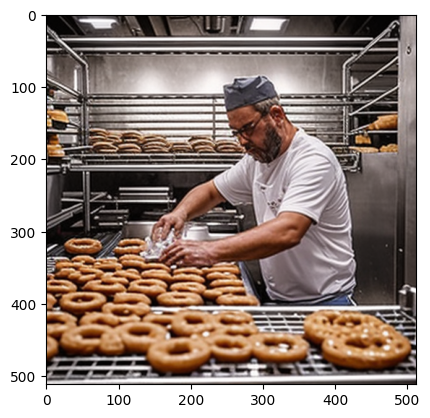

In [32]:
plt.imshow(demo)

In [45]:
import time

In [ ]:
# from PIL import ImageEnhance

In [46]:
## batch processing - 49 images from 49 prompts

from tqdm import tqdm

total_time = 0

for idx, prompt in enumerate(tqdm(prompts, desc="Generating images")):
    try:
        ind_time_start = time.time()
        image = pipe(prompt, height=512, width=512, num_inference_steps=4, guidance_scale=0.1).images[0]
        ind_time_ends = time.time()
        time_taken = ind_time_ends-ind_time_start
        print('Time taken to generate this image: ', ind_time_ends-ind_time_start)
        #sharpened = ImageEnhance.Sharpness(image).enhance(3.0)
        filename = os.path.join(output_dir, f"{idx+1:04d}.png")
        image.save(filename)
        print(f"Saved {filename}")
        total_time += time_taken
    except Exception as e:
        print(f"Failed for prompt {idx+1}: {prompt}\n{e}")

print(f"Total time taken for {len(prompts)} images: {total_time/60} minutes")

Generating images:   0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/4 [00:00<?, ?it/s]

Generating images:   2%|▏         | 1/49 [00:01<01:23,  1.74s/it]

Time taken to generate this image:  1.621762990951538
Saved /content/drive/MyDrive/Colab Notebooks/J Application Workstation/Dreamslayer/final_outputs/0001.png


  0%|          | 0/4 [00:00<?, ?it/s]

Generating images:   4%|▍         | 2/49 [00:03<01:21,  1.72s/it]

Time taken to generate this image:  1.5649235248565674
Saved /content/drive/MyDrive/Colab Notebooks/J Application Workstation/Dreamslayer/final_outputs/0002.png


  0%|          | 0/4 [00:00<?, ?it/s]

Generating images:   6%|▌         | 3/49 [00:05<01:18,  1.70s/it]

Time taken to generate this image:  1.5749015808105469
Saved /content/drive/MyDrive/Colab Notebooks/J Application Workstation/Dreamslayer/final_outputs/0003.png


  0%|          | 0/4 [00:00<?, ?it/s]

Generating images:   8%|▊         | 4/49 [00:06<01:16,  1.69s/it]

Time taken to generate this image:  1.557058334350586
Saved /content/drive/MyDrive/Colab Notebooks/J Application Workstation/Dreamslayer/final_outputs/0004.png


  0%|          | 0/4 [00:00<?, ?it/s]

Generating images:  10%|█         | 5/49 [00:08<01:13,  1.68s/it]

Time taken to generate this image:  1.5637781620025635
Saved /content/drive/MyDrive/Colab Notebooks/J Application Workstation/Dreamslayer/final_outputs/0005.png


  0%|          | 0/4 [00:00<?, ?it/s]

Generating images:  12%|█▏        | 6/49 [00:10<01:12,  1.68s/it]

Time taken to generate this image:  1.5706186294555664
Saved /content/drive/MyDrive/Colab Notebooks/J Application Workstation/Dreamslayer/final_outputs/0006.png


  0%|          | 0/4 [00:00<?, ?it/s]

Generating images:  14%|█▍        | 7/49 [00:11<01:09,  1.66s/it]

Time taken to generate this image:  1.5707809925079346
Saved /content/drive/MyDrive/Colab Notebooks/J Application Workstation/Dreamslayer/final_outputs/0007.png


  0%|          | 0/4 [00:00<?, ?it/s]

Generating images:  16%|█▋        | 8/49 [00:13<01:08,  1.67s/it]

Time taken to generate this image:  1.5792980194091797
Saved /content/drive/MyDrive/Colab Notebooks/J Application Workstation/Dreamslayer/final_outputs/0008.png


  0%|          | 0/4 [00:00<?, ?it/s]

Generating images:  18%|█▊        | 9/49 [00:15<01:07,  1.68s/it]

Time taken to generate this image:  1.597557544708252
Saved /content/drive/MyDrive/Colab Notebooks/J Application Workstation/Dreamslayer/final_outputs/0009.png


  0%|          | 0/4 [00:00<?, ?it/s]

Generating images:  20%|██        | 10/49 [00:16<01:05,  1.69s/it]

Time taken to generate this image:  1.5970277786254883
Saved /content/drive/MyDrive/Colab Notebooks/J Application Workstation/Dreamslayer/final_outputs/0010.png


  0%|          | 0/4 [00:00<?, ?it/s]

Generating images:  22%|██▏       | 11/49 [00:18<01:04,  1.70s/it]

Time taken to generate this image:  1.618962049484253
Saved /content/drive/MyDrive/Colab Notebooks/J Application Workstation/Dreamslayer/final_outputs/0011.png


  0%|          | 0/4 [00:00<?, ?it/s]

Generating images:  24%|██▍       | 12/49 [00:20<01:02,  1.70s/it]

Time taken to generate this image:  1.5990359783172607
Saved /content/drive/MyDrive/Colab Notebooks/J Application Workstation/Dreamslayer/final_outputs/0012.png


  0%|          | 0/4 [00:00<?, ?it/s]

Generating images:  27%|██▋       | 13/49 [00:22<01:01,  1.71s/it]

Time taken to generate this image:  1.605327844619751
Saved /content/drive/MyDrive/Colab Notebooks/J Application Workstation/Dreamslayer/final_outputs/0013.png


  0%|          | 0/4 [00:00<?, ?it/s]

Generating images:  29%|██▊       | 14/49 [00:23<00:59,  1.71s/it]

Time taken to generate this image:  1.6111335754394531
Saved /content/drive/MyDrive/Colab Notebooks/J Application Workstation/Dreamslayer/final_outputs/0014.png


  0%|          | 0/4 [00:00<?, ?it/s]

Generating images:  31%|███       | 15/49 [00:25<00:58,  1.72s/it]

Time taken to generate this image:  1.5992374420166016
Saved /content/drive/MyDrive/Colab Notebooks/J Application Workstation/Dreamslayer/final_outputs/0015.png


  0%|          | 0/4 [00:00<?, ?it/s]

Generating images:  33%|███▎      | 16/49 [00:27<00:56,  1.71s/it]

Time taken to generate this image:  1.5945048332214355
Saved /content/drive/MyDrive/Colab Notebooks/J Application Workstation/Dreamslayer/final_outputs/0016.png


  0%|          | 0/4 [00:00<?, ?it/s]

Generating images:  35%|███▍      | 17/49 [00:28<00:55,  1.72s/it]

Time taken to generate this image:  1.6225275993347168
Saved /content/drive/MyDrive/Colab Notebooks/J Application Workstation/Dreamslayer/final_outputs/0017.png


  0%|          | 0/4 [00:00<?, ?it/s]

Generating images:  37%|███▋      | 18/49 [00:30<00:53,  1.71s/it]

Time taken to generate this image:  1.615319013595581
Saved /content/drive/MyDrive/Colab Notebooks/J Application Workstation/Dreamslayer/final_outputs/0018.png


  0%|          | 0/4 [00:00<?, ?it/s]

Generating images:  39%|███▉      | 19/49 [00:32<00:51,  1.71s/it]

Time taken to generate this image:  1.5901317596435547
Saved /content/drive/MyDrive/Colab Notebooks/J Application Workstation/Dreamslayer/final_outputs/0019.png


  0%|          | 0/4 [00:00<?, ?it/s]

Generating images:  41%|████      | 20/49 [00:34<00:49,  1.71s/it]

Time taken to generate this image:  1.5765371322631836
Saved /content/drive/MyDrive/Colab Notebooks/J Application Workstation/Dreamslayer/final_outputs/0020.png


  0%|          | 0/4 [00:00<?, ?it/s]

Generating images:  43%|████▎     | 21/49 [00:35<00:47,  1.70s/it]

Time taken to generate this image:  1.5810494422912598
Saved /content/drive/MyDrive/Colab Notebooks/J Application Workstation/Dreamslayer/final_outputs/0021.png


  0%|          | 0/4 [00:00<?, ?it/s]

Generating images:  45%|████▍     | 22/49 [00:37<00:45,  1.70s/it]

Time taken to generate this image:  1.5817673206329346
Saved /content/drive/MyDrive/Colab Notebooks/J Application Workstation/Dreamslayer/final_outputs/0022.png


  0%|          | 0/4 [00:00<?, ?it/s]

Generating images:  47%|████▋     | 23/49 [00:39<00:43,  1.69s/it]

Time taken to generate this image:  1.5788829326629639
Saved /content/drive/MyDrive/Colab Notebooks/J Application Workstation/Dreamslayer/final_outputs/0023.png


  0%|          | 0/4 [00:00<?, ?it/s]

Generating images:  49%|████▉     | 24/49 [00:40<00:42,  1.68s/it]

Time taken to generate this image:  1.578751802444458
Saved /content/drive/MyDrive/Colab Notebooks/J Application Workstation/Dreamslayer/final_outputs/0024.png


  0%|          | 0/4 [00:00<?, ?it/s]

Generating images:  51%|█████     | 25/49 [00:42<00:40,  1.70s/it]

Time taken to generate this image:  1.5998857021331787
Saved /content/drive/MyDrive/Colab Notebooks/J Application Workstation/Dreamslayer/final_outputs/0025.png


  0%|          | 0/4 [00:00<?, ?it/s]

Generating images:  53%|█████▎    | 26/49 [00:44<00:38,  1.69s/it]

Time taken to generate this image:  1.573974370956421
Saved /content/drive/MyDrive/Colab Notebooks/J Application Workstation/Dreamslayer/final_outputs/0026.png


  0%|          | 0/4 [00:00<?, ?it/s]

Generating images:  55%|█████▌    | 27/49 [00:45<00:36,  1.67s/it]

Time taken to generate this image:  1.5637142658233643
Saved /content/drive/MyDrive/Colab Notebooks/J Application Workstation/Dreamslayer/final_outputs/0027.png


  0%|          | 0/4 [00:00<?, ?it/s]

Generating images:  57%|█████▋    | 28/49 [00:47<00:35,  1.67s/it]

Time taken to generate this image:  1.5491299629211426
Saved /content/drive/MyDrive/Colab Notebooks/J Application Workstation/Dreamslayer/final_outputs/0028.png


  0%|          | 0/4 [00:00<?, ?it/s]

Generating images:  59%|█████▉    | 29/49 [00:49<00:33,  1.67s/it]

Time taken to generate this image:  1.5537314414978027
Saved /content/drive/MyDrive/Colab Notebooks/J Application Workstation/Dreamslayer/final_outputs/0029.png


  0%|          | 0/4 [00:00<?, ?it/s]

Generating images:  61%|██████    | 30/49 [00:50<00:31,  1.66s/it]

Time taken to generate this image:  1.552314281463623
Saved /content/drive/MyDrive/Colab Notebooks/J Application Workstation/Dreamslayer/final_outputs/0030.png


  0%|          | 0/4 [00:00<?, ?it/s]

Generating images:  63%|██████▎   | 31/49 [00:52<00:29,  1.66s/it]

Time taken to generate this image:  1.5480773448944092
Saved /content/drive/MyDrive/Colab Notebooks/J Application Workstation/Dreamslayer/final_outputs/0031.png


  0%|          | 0/4 [00:00<?, ?it/s]

Generating images:  65%|██████▌   | 32/49 [00:54<00:28,  1.67s/it]

Time taken to generate this image:  1.5554485321044922
Saved /content/drive/MyDrive/Colab Notebooks/J Application Workstation/Dreamslayer/final_outputs/0032.png


  0%|          | 0/4 [00:00<?, ?it/s]

Generating images:  67%|██████▋   | 33/49 [00:55<00:26,  1.68s/it]

Time taken to generate this image:  1.5632612705230713
Saved /content/drive/MyDrive/Colab Notebooks/J Application Workstation/Dreamslayer/final_outputs/0033.png


  0%|          | 0/4 [00:00<?, ?it/s]

Generating images:  69%|██████▉   | 34/49 [00:57<00:25,  1.68s/it]

Time taken to generate this image:  1.558429479598999
Saved /content/drive/MyDrive/Colab Notebooks/J Application Workstation/Dreamslayer/final_outputs/0034.png


  0%|          | 0/4 [00:00<?, ?it/s]

Generating images:  71%|███████▏  | 35/49 [00:59<00:23,  1.68s/it]

Time taken to generate this image:  1.5557234287261963
Saved /content/drive/MyDrive/Colab Notebooks/J Application Workstation/Dreamslayer/final_outputs/0035.png


  0%|          | 0/4 [00:00<?, ?it/s]

Generating images:  73%|███████▎  | 36/49 [01:00<00:21,  1.67s/it]

Time taken to generate this image:  1.5517256259918213
Saved /content/drive/MyDrive/Colab Notebooks/J Application Workstation/Dreamslayer/final_outputs/0036.png


  0%|          | 0/4 [00:00<?, ?it/s]

Generating images:  76%|███████▌  | 37/49 [01:02<00:20,  1.67s/it]

Time taken to generate this image:  1.5517897605895996
Saved /content/drive/MyDrive/Colab Notebooks/J Application Workstation/Dreamslayer/final_outputs/0037.png


  0%|          | 0/4 [00:00<?, ?it/s]

Time taken to generate this image:  1.5595312118530273


Generating images:  78%|███████▊  | 38/49 [01:04<00:18,  1.71s/it]

Saved /content/drive/MyDrive/Colab Notebooks/J Application Workstation/Dreamslayer/final_outputs/0038.png


  0%|          | 0/4 [00:00<?, ?it/s]

Time taken to generate this image:  1.5601911544799805


Generating images:  80%|███████▉  | 39/49 [01:06<00:17,  1.74s/it]

Saved /content/drive/MyDrive/Colab Notebooks/J Application Workstation/Dreamslayer/final_outputs/0039.png


  0%|          | 0/4 [00:00<?, ?it/s]

Generating images:  82%|████████▏ | 40/49 [01:07<00:15,  1.75s/it]

Time taken to generate this image:  1.654334306716919
Saved /content/drive/MyDrive/Colab Notebooks/J Application Workstation/Dreamslayer/final_outputs/0040.png


  0%|          | 0/4 [00:00<?, ?it/s]

Time taken to generate this image:  1.5787699222564697


Generating images:  84%|████████▎ | 41/49 [01:09<00:14,  1.78s/it]

Saved /content/drive/MyDrive/Colab Notebooks/J Application Workstation/Dreamslayer/final_outputs/0041.png


  0%|          | 0/4 [00:00<?, ?it/s]

Generating images:  86%|████████▌ | 42/49 [01:11<00:12,  1.76s/it]

Time taken to generate this image:  1.6116535663604736
Saved /content/drive/MyDrive/Colab Notebooks/J Application Workstation/Dreamslayer/final_outputs/0042.png


  0%|          | 0/4 [00:00<?, ?it/s]

Generating images:  88%|████████▊ | 43/49 [01:13<00:10,  1.74s/it]

Time taken to generate this image:  1.5412375926971436
Saved /content/drive/MyDrive/Colab Notebooks/J Application Workstation/Dreamslayer/final_outputs/0043.png


  0%|          | 0/4 [00:00<?, ?it/s]

Generating images:  90%|████████▉ | 44/49 [01:14<00:08,  1.76s/it]

Time taken to generate this image:  1.6858150959014893
Saved /content/drive/MyDrive/Colab Notebooks/J Application Workstation/Dreamslayer/final_outputs/0044.png


  0%|          | 0/4 [00:00<?, ?it/s]

Generating images:  92%|█████████▏| 45/49 [01:16<00:06,  1.73s/it]

Time taken to generate this image:  1.5518534183502197
Saved /content/drive/MyDrive/Colab Notebooks/J Application Workstation/Dreamslayer/final_outputs/0045.png


  0%|          | 0/4 [00:00<?, ?it/s]

Generating images:  94%|█████████▍| 46/49 [01:18<00:05,  1.71s/it]

Time taken to generate this image:  1.544665813446045
Saved /content/drive/MyDrive/Colab Notebooks/J Application Workstation/Dreamslayer/final_outputs/0046.png


  0%|          | 0/4 [00:00<?, ?it/s]

Generating images:  96%|█████████▌| 47/49 [01:19<00:03,  1.70s/it]

Time taken to generate this image:  1.5481557846069336
Saved /content/drive/MyDrive/Colab Notebooks/J Application Workstation/Dreamslayer/final_outputs/0047.png


  0%|          | 0/4 [00:00<?, ?it/s]

Generating images:  98%|█████████▊| 48/49 [01:21<00:01,  1.70s/it]

Time taken to generate this image:  1.5506670475006104
Saved /content/drive/MyDrive/Colab Notebooks/J Application Workstation/Dreamslayer/final_outputs/0048.png


  0%|          | 0/4 [00:00<?, ?it/s]

Generating images: 100%|██████████| 49/49 [01:23<00:00,  1.70s/it]

Time taken to generate this image:  1.5656700134277344
Saved /content/drive/MyDrive/Colab Notebooks/J Application Workstation/Dreamslayer/final_outputs/0049.png
Total time taken for 49 images: 1.2896771113077798 minutes


In [48]:
print(total_time/60, "minutes")

1.2896771113077798 minutes


0001.png----A man baking and preparing donuts to sell at shop.


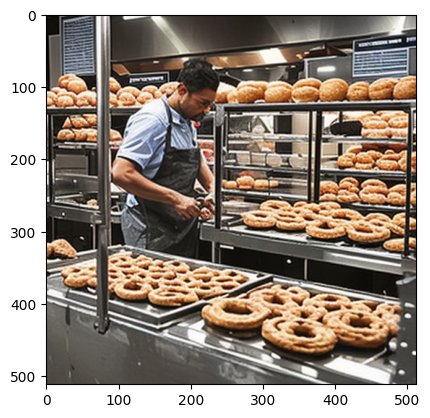




0002.png----A zebra chews a flower in a fenced in field.


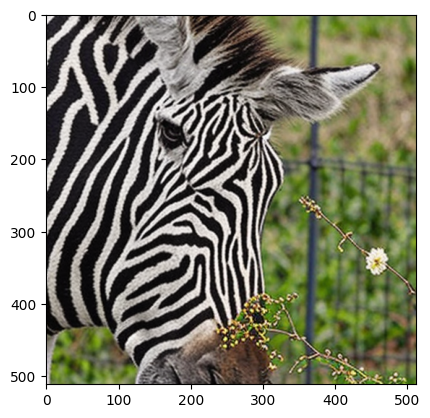




0003.png----A person skiing down a  mountain kicking his leg up.


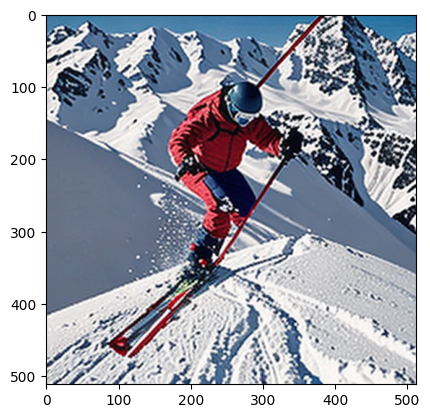




0004.png----An airplane in route with a cloudy sky behind it.


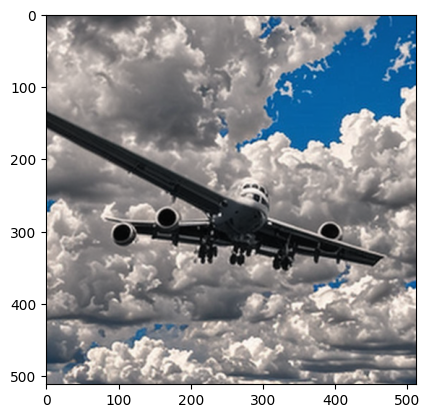




0005.png----A white and blue truck parked in the middle of a dirt road.


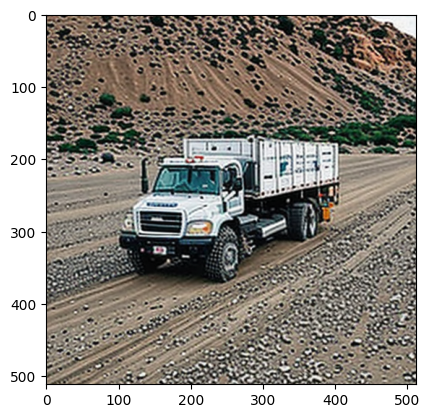




0006.png----PIcked peach flowers sit in a vase with water.


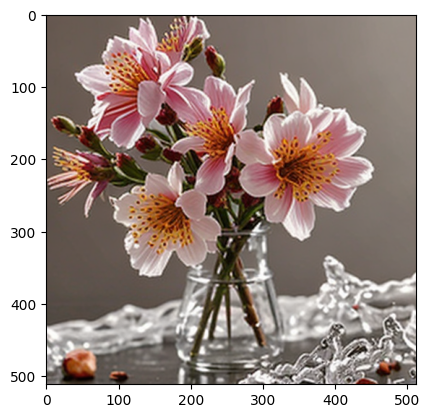




0007.png----Sheep are on a grassy field and one of them is a white and black baby.


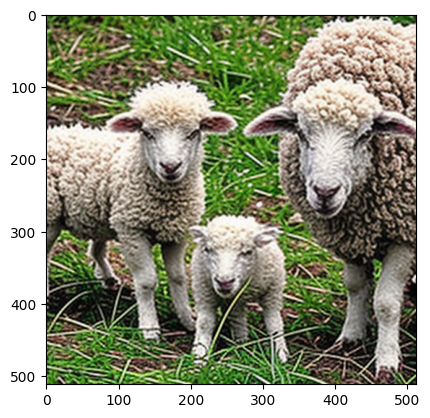




0008.png----A blue rusted train engine sitting on top of rail tracks.


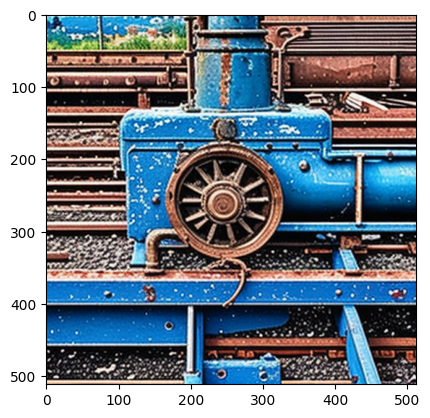




0009.png----An open laptop computer sitting on top of a wooden table.


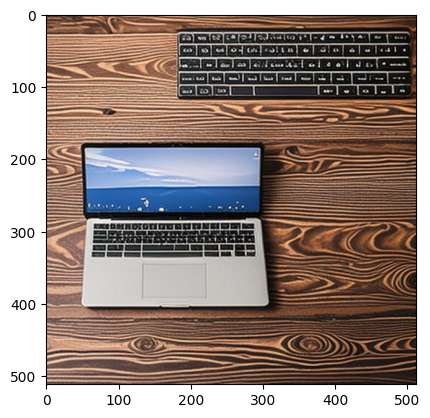




0010.png----A woman twirling an umbrella with flowers on it.


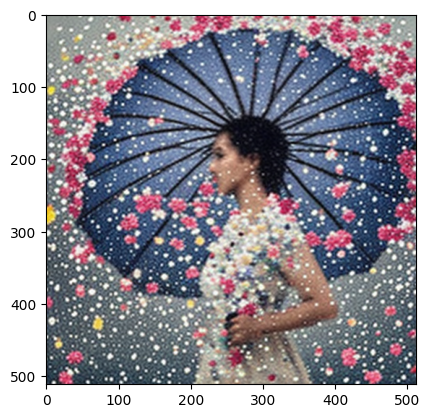




0011.png----A woman sitting in a restaurant with Mexican food on her plate


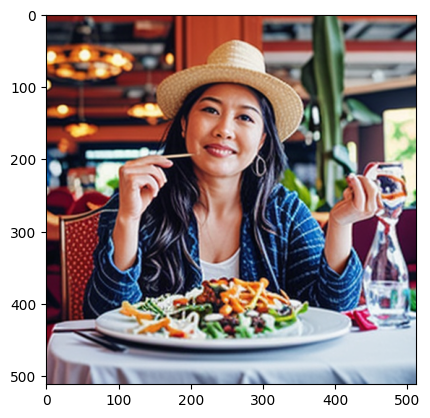




0012.png----A woman holding a purse and a cellphone.


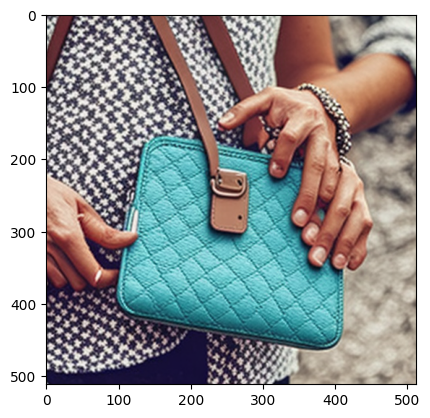




0013.png----A cat reaching for a knife that has it's blade out.


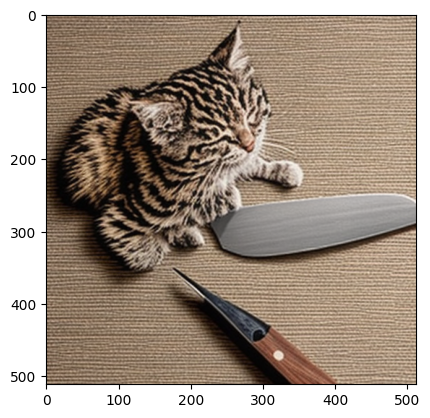




0014.png----The man smiles with a slice of pizza while next to a friend.


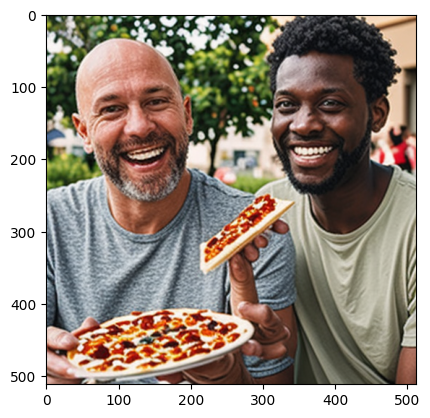




0015.png----Night picture of a car parked and some parking lights in the distance.


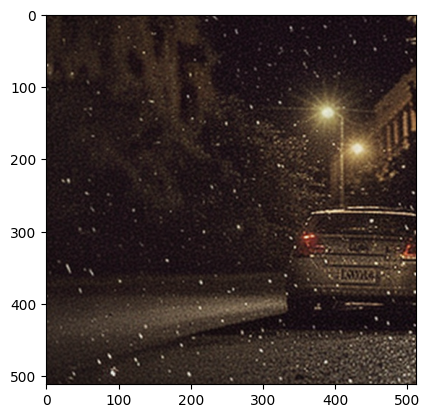




0016.png----A professional photograph of a motorcycle rider in the air.


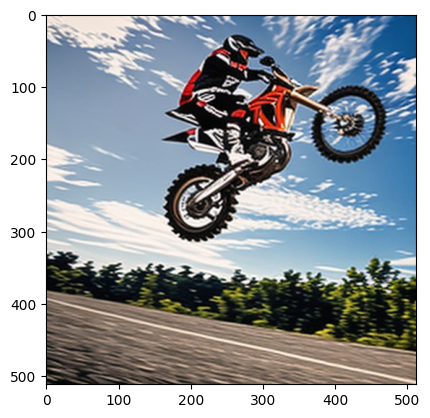




0017.png----A person putting doughnuts into a bag in a shop.


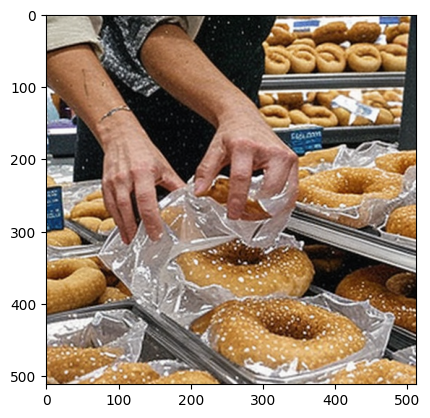




0018.png----A very ornately decorated and brightly colored clock.


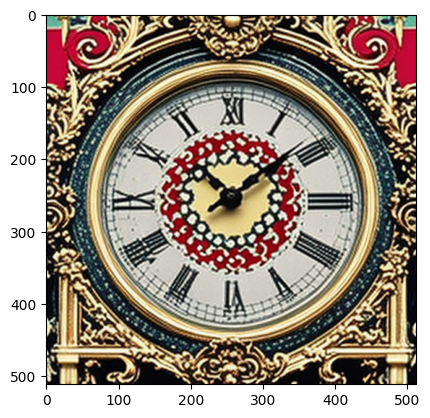




0019.png----A young man that is having some wine and something to eat.


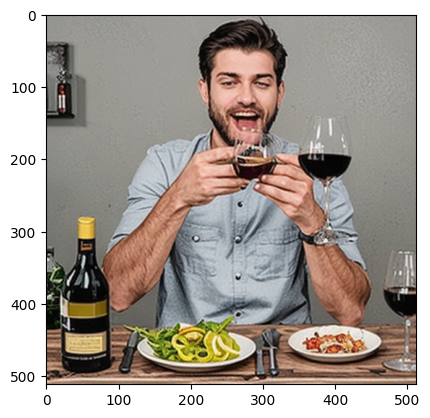




0020.png----A picture of pink bathroom sink and a mirror.


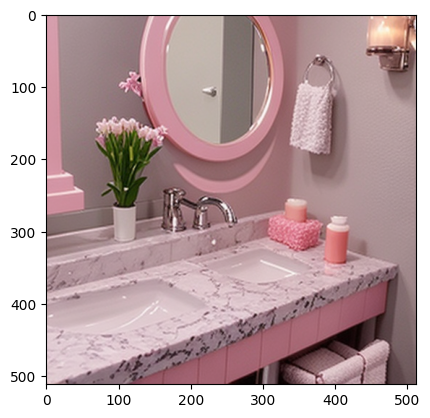




0021.png----people standing in line beside a food truck


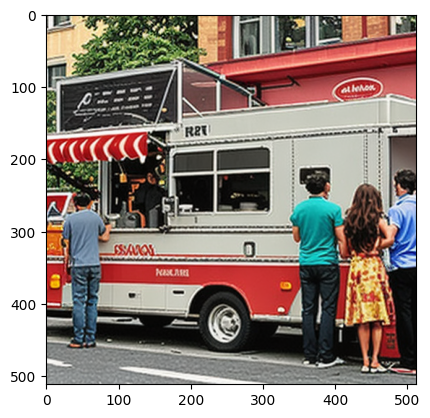




0022.png----Single sheep in a field looking back at camera.


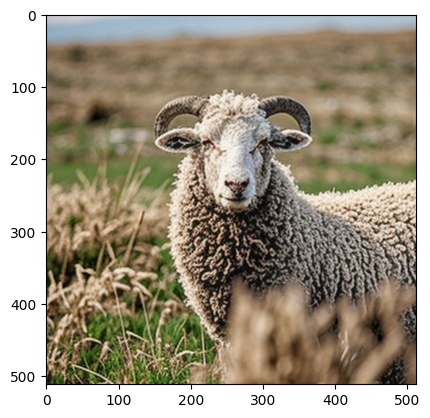




0023.png----A few pizza slices next to a couple of bread slices.


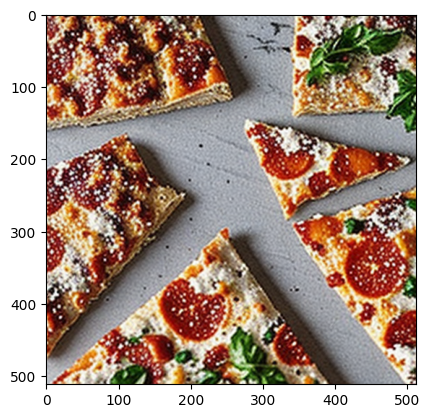




0024.png----Two giraffe standing in a field next to trees.


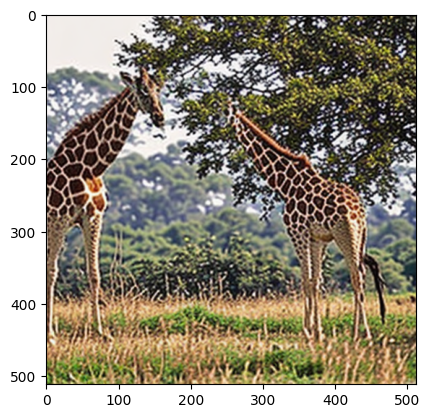




0025.png----A person in rubber boots and a rain coat seated on a bench.


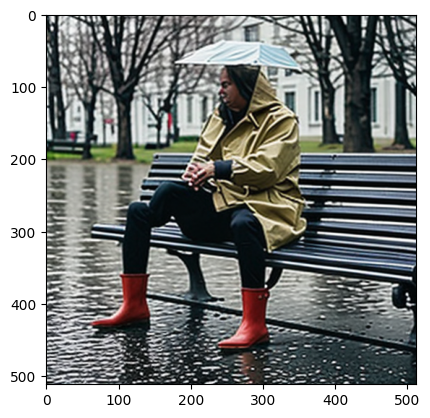




0026.png----A giraffe standing next to a  bamboo building.


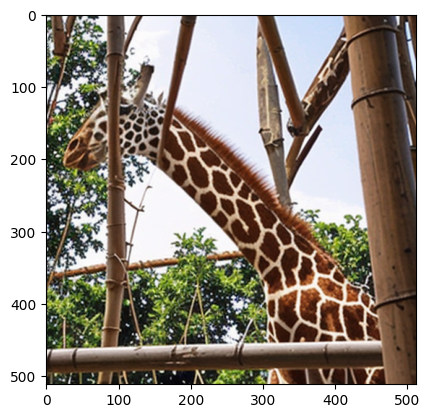




0027.png----A large combination pizza with two pieces gone.


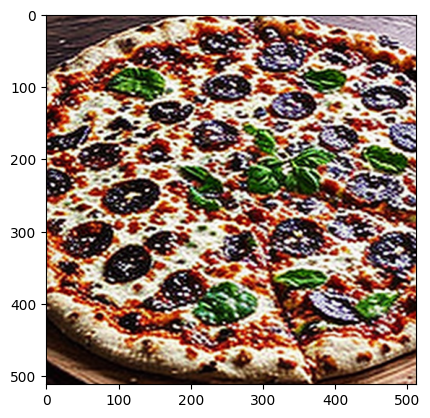




0028.png----A bearded man in a suit eating pizza.


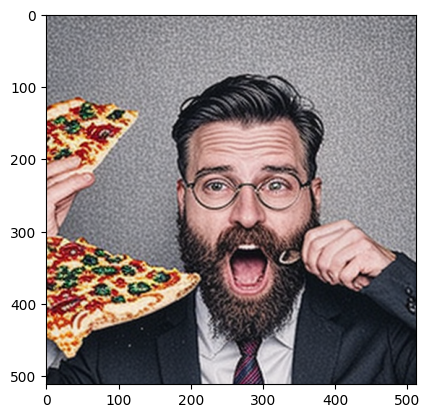




0029.png----An old yellow train is waiting at the station.


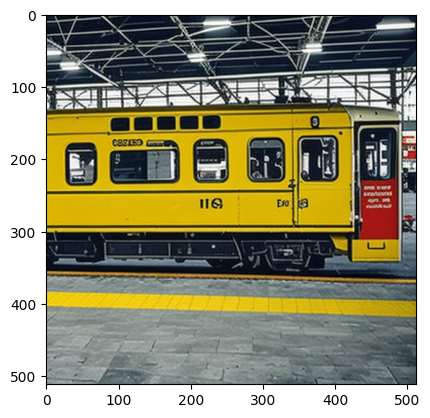




0030.png----People flying kites in a park next to a lake.


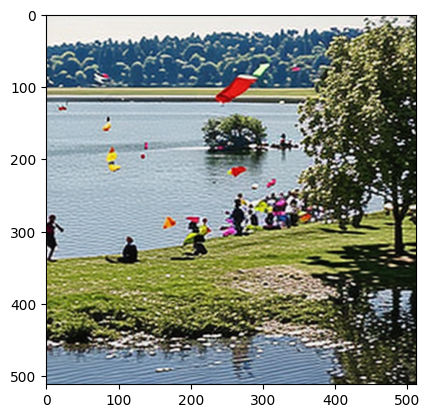




0031.png----A young man is body surfing and paddling in the water.


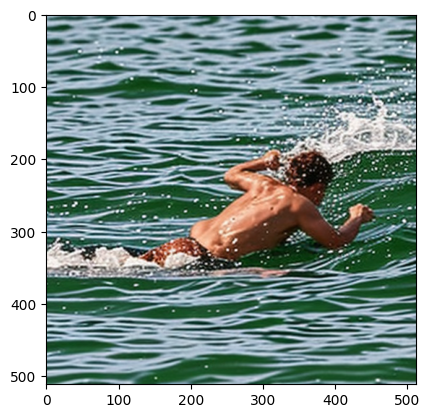




0032.png----A very large stuffed giraffe posed looking out a window.


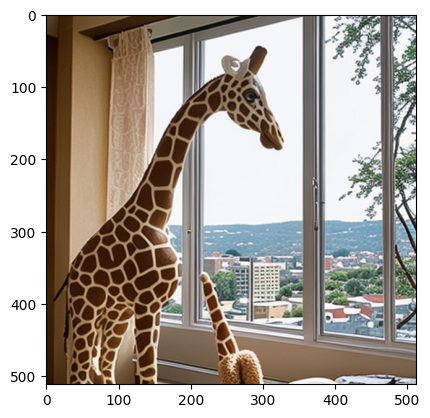




0033.png----A dim room with toilet bowls lined along the wall


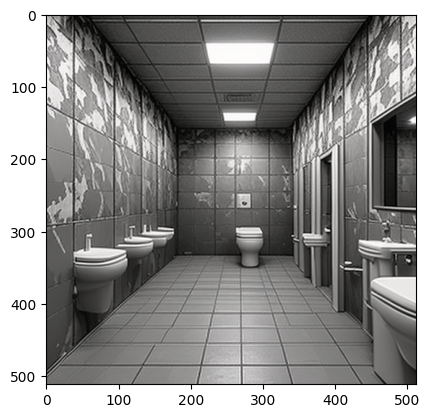




0034.png----Two trains parked at a train station as passenger wait to board them.


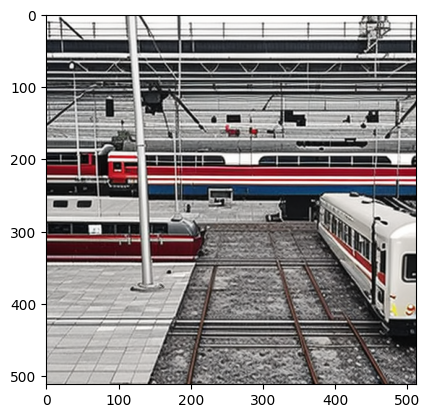




0035.png----A slightly made/messy bed against the corner in a white room.


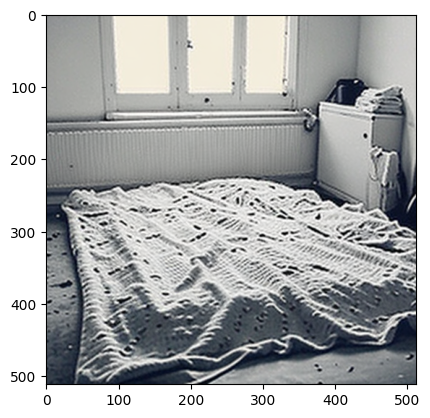




0036.png----A bench sit in front of a blue and yellow train.


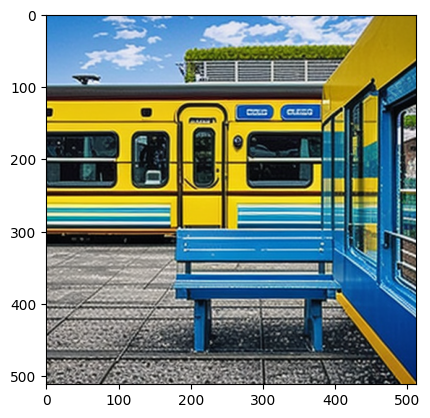




0037.png----A man is skate boarding down a path and a dog is running by his side.


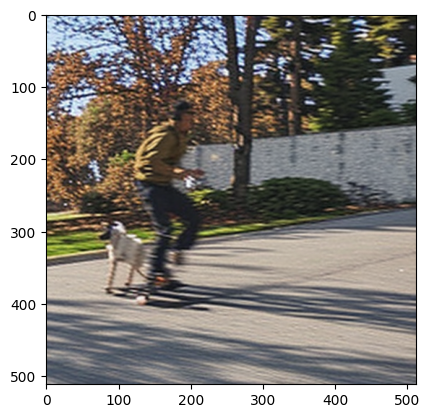




0038.png----A man on a long exposure picture riding an electric skateboard.


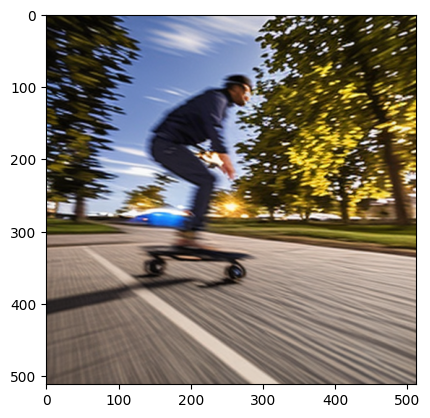




0039.png----A person on skis and with poles in the snow and facing the blue sky.


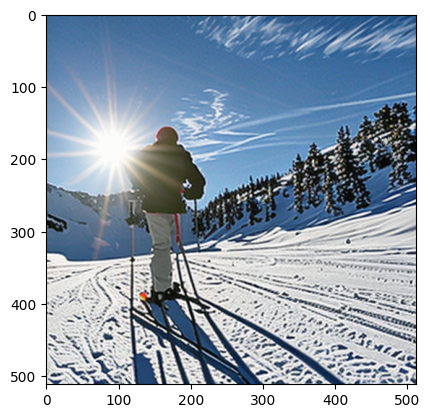




0040.png----a cake with a section missing sitting next to a burning candle


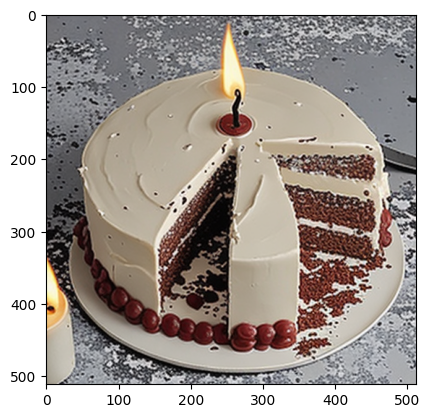




0041.png----a woman selling jewelry laid on a blanket on the sidewalk


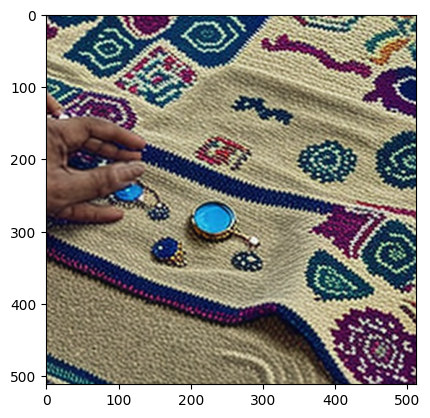




0042.png----A group of people on a tennis court.


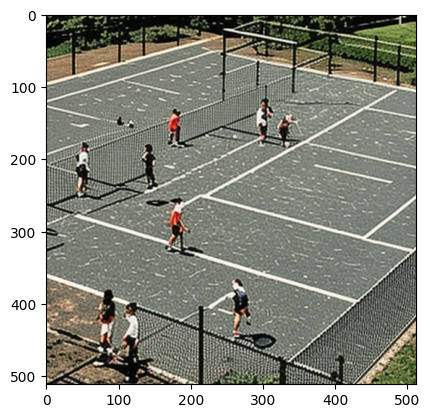




0043.png----Two large elephants walking behind a wire fence on green grass.


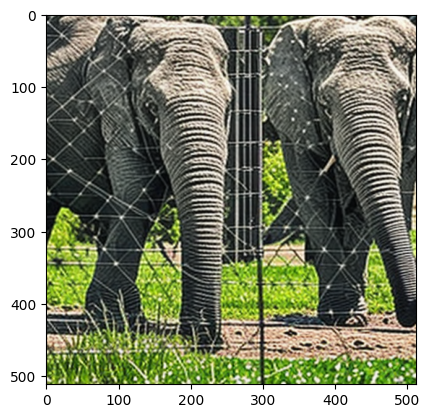




0044.png----a woman on a tennis court getting ready to serve the ball


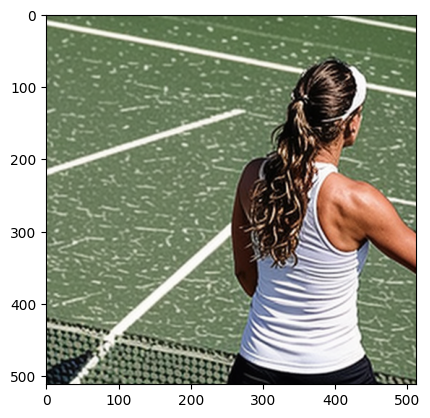




0045.png----Tabby cat with green eyes wearing a hat


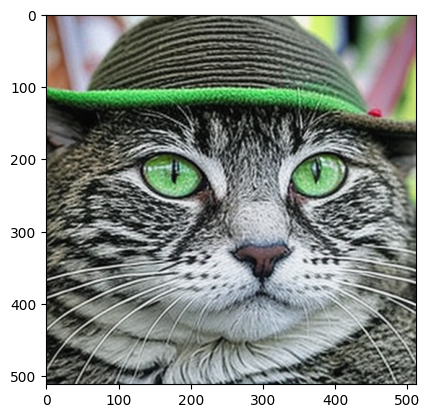




0046.png----A small, white formica kitchen with a refrigerator, sink and small electrical appliances


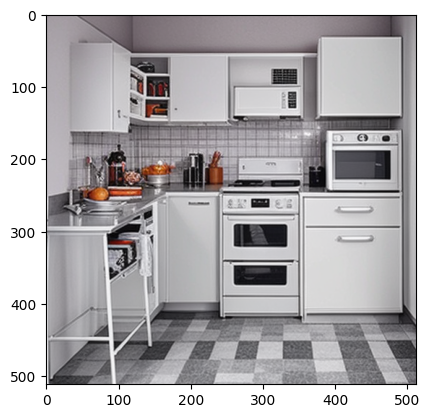




0047.png----A tall clock tower with a large clock on it's face.


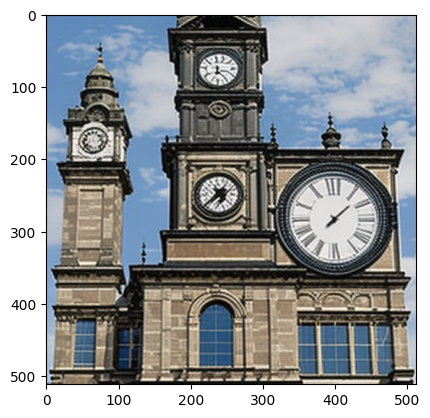




0048.png----A bathroom with a toilet, tub, mirror, window and a shower pole.


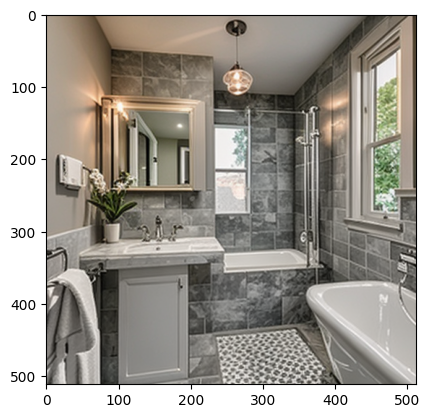




0049.png----A group of people standing on a snow covered hill.


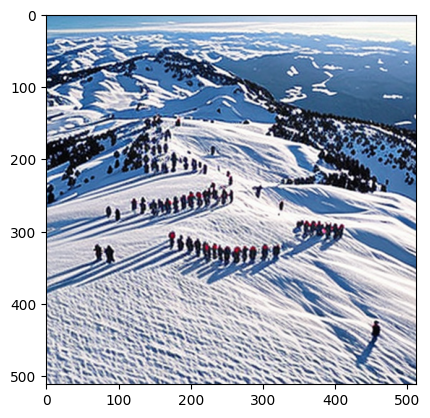

In [54]:
counter = 0
for i in os.listdir(output_dir):
  print(i + "----" +  prompts[counter])
  img = plt.imread(f"{output_dir}/{i}")
  plt.imshow(img)
  plt.show()
  counter += 1
  print("\n\n")